In [6]:
import pandas as pd
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline  

from io import StringIO
from sklearn.preprocessing import StandardScaler
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

In [2]:
root = r"../data/input/07 Samsung UX Index - Web App Implementation/"

fname_data = root + r"Samsung UX Index Survey_Data.csv"
df_data = pd.read_csv(fname_data)

fname_vaxmap = root + r"Samsung UX Index Survey_Datamap.xlsx"
df_varmap = pd.read_excel(fname_vaxmap, header=1, sheet_name=0)
df_valmap = pd.read_excel(fname_vaxmap, header=1, sheet_name=1)



/usr/local/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3057: DtypeWarning: Columns (1218) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


# PCA of all [qx] columns

In [7]:
# select columns that start with qx
qx_list = [ x for x in df_data.columns if 'qx' in x ]
print(len(qx_list))

# drop qxcurrentxmodel (Which smartphone model do you currently use...)
qx_list = [ x for x in qx_list if 'qxcurrentxmodel' not in x ]
print(len(qx_list))

# drop qxotherxdevices (Q_Other_Devices. XXX - XX - What brands of the following devices do you own?)
qx_list = [ x for x in qx_list if 'qxotherxdevices' not in x ]
print(len(qx_list))

# drop qxcurrentxcarrier (Q_Current_Carrier. Which mobile carrier do you use on your...?)
qx_list = [ x for x in qx_list if 'qxcurrentxcarrier' not in x ]
print(len(qx_list))

# drop qxcurrentxos (Q_Current_OS. Which version of XXX are you currently using on your smartphone?)
qx_list = [ x for x in qx_list if 'qxcurrentxos' not in x ]
print(len(qx_list))

# drop qxcurrentxstorage
qx_list = [ x for x in qx_list if 'qxcurrentxstorage' not in x ]
print(len(qx_list))

# drop qxpreviousxbrand
qx_list = [ x for x in qx_list if 'qxpreviousxbrand' not in x ]
print(len(qx_list))

# drop qxpreviousxmodel
qx_list = [ x for x in qx_list if 'qxpreviousxmodel' not in x ]
print(len(qx_list))

# drop qxupgrade
qx_list = [ x for x in qx_list if 'qxupgrade' not in x ]
print(len(qx_list))

# drop qxdriversxoe (QxDriversxOE. What else, besides those things 
# that you have just rated, is important for you in a smartphone? 
# Please think about it at a higher level, in terms of what a 
# smartphone can do for you, how it may make you feel, and how you 
# would like the proce)
qx_list = [ x for x in qx_list if 'xoe' not in x ]
print(len(qx_list))

df_data_sub = df_data[qx_list]

# list all column categories
print( np.unique(np.array(([x.split('_')[0] for x in df_data_sub.columns]))))

# list non  integer columns  to be coerced into ints
coerce_cols = df_data_sub.dtypes[df_data_sub.dtypes!='int64'].index.to_list()
df_data_sub[coerce_cols] = df_data_sub[coerce_cols].apply(pd.to_numeric, errors='coerce')

# list all column types
print( np.unique(np.array(([x.split('_')[0] for x in df_data_sub.columns]))))

# confirm all are numeric types
print(np.unique(df_data_sub.dtypes.to_frame()[0].to_list()))

df_data_sub.describe()

1170
1169
1115
1113
1110
1109
1107
1087
1077
1076
['qxactivitiesxdrivers' 'qxactivitiesximportance'
 'qxactivitiesxqualityxindicators' 'qxactivitiesxrecency'
 'qxactivitiesxsatisfaction' 'qxadvocacy01' 'qxadvocacy02' 'qxbrandxlove'
 'qxbrandxtrustxdrivers' 'qxdrivers' 'qxenrichment' 'qxexpectations'
 'qxoverallxqualityxindicators' 'qxretention' 'qxtime' 'qxtransition'
 'qxunlocking']


/usr/local/lib/python3.7/site-packages/pandas/core/frame.py:3489: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


['qxactivitiesxdrivers' 'qxactivitiesximportance'
 'qxactivitiesxqualityxindicators' 'qxactivitiesxrecency'
 'qxactivitiesxsatisfaction' 'qxadvocacy01' 'qxadvocacy02' 'qxbrandxlove'
 'qxbrandxtrustxdrivers' 'qxdrivers' 'qxenrichment' 'qxexpectations'
 'qxoverallxqualityxindicators' 'qxretention' 'qxtime' 'qxtransition'
 'qxunlocking']
[dtype('int64') dtype('float64')]


,qxtime,qxoverallxqualityxindicators_1,qxoverallxqualityxindicators_2,qxoverallxqualityxindicators_3,qxoverallxqualityxindicators_4,qxactivitiesximportance_1,qxactivitiesximportance_2,qxactivitiesximportance_3,qxactivitiesximportance_4,qxactivitiesximportance_5,...,qxactivitiesxdrivers_28_25,qxactivitiesxdrivers_29_25,qxactivitiesxdrivers_30_25,qxactivitiesxdrivers_31_25,qxactivitiesxdrivers_32_25,qxactivitiesxdrivers_33_25,qxactivitiesxdrivers_34_25,qxunlocking,qxtransition_1,qxexpectations
count,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,3254.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3254.000000,3133.000000,3254.000000
mean,4.086355,5.744007,5.775661,5.905040,6.094960,5.522434,6.251998,5.031346,5.748617,5.801475,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.946220,5.776891,5.366318
std,1.428137,1.269394,1.220311,1.207067,1.095453,1.471928,1.106302,1.674275,1.442447,1.330407,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.031839,1.327219,1.291195
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,1.000000
25%,3.000000,5.000000,5.000000,5.000000,6.000000,5.000000,6.000000,4.000000,5.000000,5.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,5.000000,4.000000
50%,4.000000,6.000000,6.000000,6.000000,6.000000,6.000000,7.000000,5.000000,6.000000,6.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000,6.000000,5.000000
75%,5.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,6.000000,7.000000,7.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000,7.000000,6.000000
max,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.000000,7.000000,7.000000


In [8]:
# Count Na values
df_data_sub.isna().sum()[df_data_sub.isna().sum()>0]

qxactivitiesxqualityxindicators_1_1     470
qxactivitiesxqualityxindicators_2_1     470
qxactivitiesxqualityxindicators_3_1     470
qxactivitiesxqualityxindicators_4_1     470
qxactivitiesxqualityxindicators_1_2     243
                                       ... 
qxactivitiesxdrivers_31_25             3254
qxactivitiesxdrivers_32_25             3254
qxactivitiesxdrivers_33_25             3254
qxactivitiesxdrivers_34_25             3254
qxtransition_1                          121
Length: 976, dtype: int64

In [22]:
# drop columns where are values are missing 
# qxactivitiesxdrivers_2_1
cols_allmissing = df_data_sub.isna().sum()[df_data_sub.isna().sum()==3254].index.to_list()
print(len(cols_allmissing))
print(df_data_sub.shape)
df_data_sub = df_data_sub.drop(cols_allmissing, axis = 1) 
print(df_data_sub.shape)

749
(3254, 1076)
(3254, 327)


In [9]:
# Standardize the qx_list columns
scaler = StandardScaler().fit(df_data_sub)
df_data_sub_std = df_data_sub.copy()
df_data_sub_std[df_data_sub.columns] = scaler.transform(df_data_sub)
df_data_sub_std.describe()

/usr/local/lib/python3.7/site-packages/sklearn/utils/extmath.py:747: RuntimeWarning: invalid value encountered in true_divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
/usr/local/lib/python3.7/site-packages/sklearn/utils/extmath.py:688: RuntimeWarning: Degrees of freedom <= 0 for slice.
  result = op(x, *args, **kwargs)


,qxtime,qxoverallxqualityxindicators_1,qxoverallxqualityxindicators_2,qxoverallxqualityxindicators_3,qxoverallxqualityxindicators_4,qxactivitiesximportance_1,qxactivitiesximportance_2,qxactivitiesximportance_3,qxactivitiesximportance_4,qxactivitiesximportance_5,...,qxactivitiesxdrivers_28_25,qxactivitiesxdrivers_29_25,qxactivitiesxdrivers_30_25,qxactivitiesxdrivers_31_25,qxactivitiesxdrivers_32_25,qxactivitiesxdrivers_33_25,qxactivitiesxdrivers_34_25,qxunlocking,qxtransition_1,qxexpectations
count,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,3.254000e+03,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.254000e+03,3.133000e+03,3.254000e+03
mean,4.367196e-17,-1.572190e-16,2.358286e-16,2.183598e-16,-2.445630e-16,-1.266487e-16,7.424233e-17,-5.349815e-17,1.048127e-16,-4.367196e-18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.353831e-16,8.164551e-17,2.096254e-16
std,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,1.000154e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000154e+00,1.000160e+00,1.000154e+00
min,-2.161439e+00,-3.737796e+00,-3.914081e+00,-4.064226e+00,-4.651722e+00,-3.072927e+00,-4.748074e+00,-2.408186e+00,-3.292562e+00,-3.609582e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.450249e+00,-3.599749e+00,-3.382131e+00
25%,-7.607972e-01,-5.862023e-01,-6.357232e-01,-7.498995e-01,-8.669895e-02,-3.549862e-01,-2.278186e-01,-6.160902e-01,-5.190707e-01,-6.025212e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-4.657679e-01,-5.854463e-01,-1.058344e+00
50%,-6.047638e-02,2.016962e-01,1.838661e-01,7.868215e-02,-8.669895e-02,3.244991e-01,6.762324e-01,-1.872503e-02,1.743021e-01,1.492441e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.647268e-02,1.681294e-01,-2.837486e-01
75%,6.398444e-01,9.895947e-01,1.003455e+00,9.072638e-01,8.263056e-01,1.003984e+00,6.762324e-01,5.786401e-01,8.676748e-01,9.010094e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.647268e-02,9.217050e-01,4.908470e-01
max,2.040486e+00,9.895947e-01,1.003455e+00,9.072638e-01,8.263056e-01,1.003984e+00,6.762324e-01,1.176005e+00,8.676748e-01,9.010094e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.487676e+00,9.217050e-01,1.265443e+00


In [23]:
# fill NA's with 0
df_data_sub_std.fillna(0, inplace=True)

In [28]:
# Count Na values
df_data_sub_std.isna().sum()[df_data_sub_std.isna().sum()>0].sum()

0

# Principal Component Analysis

In [29]:
n_components=5 
[f'principal component  {i}' for i in range(1, n_components)]

['principal component  1',
 'principal component  2',
 'principal component  3',
 'principal component  4']

In [30]:
from sklearn.preprocessing import StandardScaler
features = df_data_sub.columns
# Separating out the features
x = df_data_sub_std.loc[:, features].values

# Separating out the target
# y = df.loc[:,['target']].values
# Standardizing the features
# x = StandardScaler().fit_transform(x)

In [31]:
from sklearn.decomposition import PCA
pca = PCA(n_components=n_components)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = [f'principal component {i}' for i in range(1,1+n_components)])


# Visualize by 'vizvar'

In [32]:
df_data_pca = pd.concat([principalDf, df_data], axis = 1)

In [33]:
def vizbyvar (df_data_pca,df_valmap,df_varmap, var):
    
    LABEL = df_varmap[df_varmap.Variable==var]['Short Label'].iloc[0]
    
    
    if sum(df_valmap.key==var)>0:
        df_data_pca = df_data_pca.merge(df_valmap[df_valmap.key==var],  
              left_on=var, right_on="id", how='left')
        targets = df_valmap[df_valmap.key==var]['Label'].unique()
        colors = matplotlib.cm.get_cmap('tab20', len(targets)).colors
    elif df_data_pca[var].dtype=='float' and len(df_data_pca[var].unique())>20:
        df_data_pca['bin'] = pd.cut(df_data_pca[var], 5)
        targets =  df_data_pca['bin'].unique()
        colors = matplotlib.cm.get_cmap('tab20', len(targets)).colors
    else:
        targets = df_data_pca[var].unique()
   
    
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(1,1,1) 
    ax.set_xlabel('Principal Component 1', fontsize = 15)
    ax.set_ylabel('Principal Component 2', fontsize = 15)
    ax.set_title('PCA: '+ LABEL, fontsize = 20)


    for target, color in zip(targets,colors):
        indicesToKeep = df_data_pca.iloc[:,-1] == target
        if sum(indicesToKeep)==0:
            indicesToKeep = df_data_pca['bin'] == target
        ax.scatter(df_data_pca.loc[indicesToKeep, 'principal component 1']
                   , df_data_pca.loc[indicesToKeep, 'principal component 2']
                   , c = color
                   , s = 50)

    ax.legend(targets)
    ax.grid()


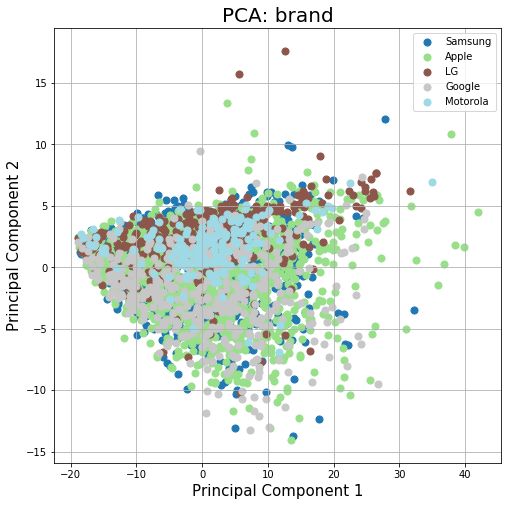

In [34]:
vizbyvar (df_data_pca,df_valmap,df_varmap, 'hbrand')

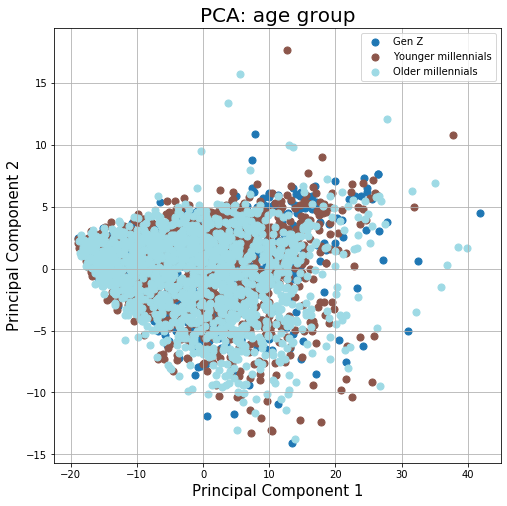

In [35]:
vizbyvar (df_data_pca,df_valmap,df_varmap, 'hidagemodels')

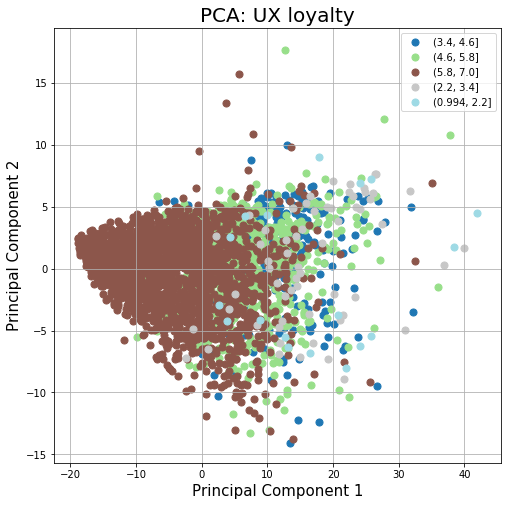

In [36]:
vizbyvar (df_data_pca,df_valmap,df_varmap, 'UX_Loyalty')

# Examining PCA

Over 33% of the variance across the 1000+ qx columns is explained by the first primary companent. The additional variable explained the the second, third, etc. components is marginal (<5%)

In [37]:
pca.explained_variance_ratio_

array([0.33798253, 0.04164875, 0.02927961, 0.02075785, 0.01720426])

Examining the importance of each of the 1000+ qx columns ...

In [38]:
pca.components_[0]

array([ 0.00739842, -0.05977506, -0.05870384, -0.05382003, -0.04888207,
       -0.03420771, -0.03102378, -0.02576586, -0.03123139, -0.03348237,
       -0.02435099, -0.03414904, -0.03877244, -0.03569366, -0.03800836,
       -0.03644246, -0.02913623, -0.03416878, -0.0322986 , -0.03631761,
       -0.0382075 , -0.03815048, -0.03203813, -0.03399184, -0.03576925,
       -0.02659901, -0.02867653, -0.03430574, -0.02956792, -0.02545048,
        0.01094525,  0.0047977 ,  0.00554768,  0.00309037,  0.0070451 ,
        0.01076602,  0.00887563,  0.00651876,  0.01212485,  0.01171448,
        0.01260195,  0.00712723,  0.00701964,  0.0065881 ,  0.00979517,
        0.01449015,  0.01173778,  0.01182171,  0.01125795,  0.00575533,
        0.01188336,  0.00482396,  0.01214831,  0.01360501,  0.01730807,
       -0.05391992, -0.05213599, -0.05042018, -0.04987067, -0.06094327,
       -0.05163266, -0.05520702, -0.05224697, -0.04340577, -0.03645924,
       -0.0402568 , -0.03763121, -0.05331593, -0.04911881, -0.04

In [39]:
abs(pca.components_[0])

array([0.00739842, 0.05977506, 0.05870384, 0.05382003, 0.04888207,
       0.03420771, 0.03102378, 0.02576586, 0.03123139, 0.03348237,
       0.02435099, 0.03414904, 0.03877244, 0.03569366, 0.03800836,
       0.03644246, 0.02913623, 0.03416878, 0.0322986 , 0.03631761,
       0.0382075 , 0.03815048, 0.03203813, 0.03399184, 0.03576925,
       0.02659901, 0.02867653, 0.03430574, 0.02956792, 0.02545048,
       0.01094525, 0.0047977 , 0.00554768, 0.00309037, 0.0070451 ,
       0.01076602, 0.00887563, 0.00651876, 0.01212485, 0.01171448,
       0.01260195, 0.00712723, 0.00701964, 0.0065881 , 0.00979517,
       0.01449015, 0.01173778, 0.01182171, 0.01125795, 0.00575533,
       0.01188336, 0.00482396, 0.01214831, 0.01360501, 0.01730807,
       0.05391992, 0.05213599, 0.05042018, 0.04987067, 0.06094327,
       0.05163266, 0.05520702, 0.05224697, 0.04340577, 0.03645924,
       0.0402568 , 0.03763121, 0.05331593, 0.04911881, 0.04967223,
       0.04782393, 0.0602406 , 0.05417927, 0.05248506, 0.05299

In [41]:
pc1_comp = pd.DataFrame(pca.components_[0],features)
pc1_comp['abs'] = abs(pc1_comp[0])
pc1_comp = pc1_comp.merge(df_varmap[['Variable','Label','Short Label']], left_index=True, right_on='Variable')
pc1_comp = pc1_comp.sort_values(by='abs', ascending=False)
pc1_comp.head(20)

,0,abs,Variable,Label,Short Label
239,-0.076411,0.076411,qxdrivers_19,Q_Drivers. My [MODEL] is fun to use - How much...,Fun
751,-0.076241,0.076241,qxactivitiesxdrivers_20_15,Q_Activities_Drivers. Taking a picture with th...,Fun - Fun rear camera
754,-0.076141,0.076141,qxactivitiesxdrivers_23_15,Q_Activities_Drivers. Taking a picture with th...,Freeing - Freeing rear camera
736,-0.075757,0.075757,qxactivitiesxdrivers_5_15,Q_Activities_Drivers. Taking a picture with th...,Aesthetically pleasing (interface) - Aesthetic...
234,-0.075343,0.075343,qxdrivers_14,Q_Drivers. If my [MODEL] had its own personali...,Personable / likeable
243,-0.075313,0.075313,qxdrivers_23,Q_Drivers. [MODEL] enables me to do what I wan...,Freeing
253,-0.075189,0.075189,qxdrivers_33,Q_Drivers. Any task on my [MODEL] can be perfo...,Efficient
747,-0.074637,0.074637,qxactivitiesxdrivers_16_15,Q_Activities_Drivers. Taking a picture with th...,Authentic / true - Authentic / true rear camera
221,-0.074633,0.074633,qxdrivers_1,Q_Drivers. My [MODEL] keeps my personal data s...,Safe / secure
739,-0.074478,0.074478,qxactivitiesxdrivers_8_15,Q_Activities_Drivers. Taking a picture with th...,Confident - Confident rear camera


In [42]:
pc1_comp.tail()

,0,abs,Variable,Label,Short Label
39,0.005548,0.005548,qxactivitiesxrecency_3,Q_Activities_Recency. Transferring files from ...,transferring files
58,0.004824,0.004824,qxactivitiesxrecency_22,Q_Activities_Recency. Creating and editing a n...,using notes
38,0.004798,0.004798,qxactivitiesxrecency_2,Q_Activities_Recency. Charging battery (includ...,charging battery
40,0.003090,0.003090,qxactivitiesxrecency_4,Q_Activities_Recency. Unlocking the smartphone...,unlocking
1112,-0.001825,0.001825,qxunlocking,Q_Unlocking. Which method do you currently use...,NaN


Importance is more or less evenly distributed, slowly decreasing across the first 275 (of 327 nonmissing) variables.

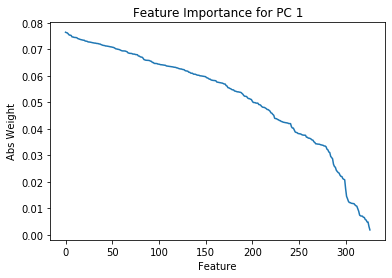

In [43]:
plt.plot(range(0, len(features)), pc1_comp['abs'])
plt.title('Feature Importance for PC 1')
plt.xlabel('Feature')
plt.ylabel('Abs Weight')
plt.show()

In [204]:
len( pc1_comp['abs'])

20

# Feature importance for PC 1
#### What types of features are important for this PC 1 that explains 33% of variance across all features?
#### Let's first examine by grouping by variable name
Largely **qxactivitiesxdrivers**, followed closely by **qxactivitiesxqualityxindicators**... and then **qxdrivers** and **qxactivitiesxsatisfaction** and **qxactivitiesximportance**.

In [46]:
pc1_comp['Variable_grp'] = [x.split('_')[0] for x in pc1_comp['Variable']] 
grouped_abs = pc1_comp.groupby('Variable_grp')['abs'].agg(['sum','count','mean']).reset_index()
grouped_abs = grouped_abs.sort_values('sum', ascending=False)
grouped_abs = grouped_abs.set_index('Variable_grp')
grouped_abs

,sum,count,mean
Variable_grp,,,
qxactivitiesxdrivers,6.166883,101,0.061058
qxactivitiesxqualityxindicators,5.144627,100,0.051446
qxdrivers,2.419253,34,0.071155
qxactivitiesxsatisfaction,1.298558,25,0.051942
qxactivitiesximportance,0.817806,25,0.032712
qxbrandxtrustxdrivers,0.282378,4,0.070594
qxactivitiesxrecency,0.239390,25,0.009576
qxoverallxqualityxindicators,0.221181,4,0.055295
qxadvocacy01,0.064615,1,0.064615


Does this change if we look at signed values, instead of abs?
*yes*-ish... Though **qxactivitiesxdrivers** have the largest impact in the absolute sense, it is all negative and driven by only 101 of the 850 total qxactivitiesxdrivers. However, each and every one of **qxactivitiesxqualityxindicators**, **qxdrivers**, **qxactivitiesxsatisfaction**, and **qxactivitiesximportance** play a role (though also a negative one).

In [48]:
pc1_comp['sign'] = np.sign(pc1_comp[0])
pc1_comp.groupby('Variable_grp').sign.value_counts().unstack().merge(grouped_abs,
                                           left_index=True, right_index=True).sort_values('mean', ascending=False)


,-1.0,1.0,sum,count,mean
Variable_grp,,,,,
qxdrivers,34.0,NaN,2.419253,34,0.071155
qxbrandxtrustxdrivers,4.0,NaN,0.282378,4,0.070594
qxadvocacy01,1.0,NaN,0.064615,1,0.064615
qxbrandxlove,1.0,NaN,0.063642,1,0.063642
qxactivitiesxdrivers,101.0,NaN,6.166883,101,0.061058
qxexpectations,1.0,NaN,0.059848,1,0.059848
qxenrichment,1.0,NaN,0.058107,1,0.058107
qxadvocacy02,1.0,NaN,0.056874,1,0.056874
qxoverallxqualityxindicators,4.0,NaN,0.221181,4,0.055295


# Feature importance for PC 1... *continued*
#### What types of features are important for this PC 1 that explains 33% of variance across all features?
#### Let's now use additional varibale mapping for more refined characteristics of these features.


In [ ]:
# Note, data was loaded by copying from XLSX and using StringIO

In [218]:
df_add1.head()

,qxcurrentmodel,hbrand
0,qxcurrentxmodel_11,hbrand_1
1,qxcurrentxmodel_12,hbrand_1
2,qxcurrentxmodel_13,hbrand_1
3,qxcurrentxmodel_14,hbrand_1
4,qxcurrentxmodel_15,hbrand_1


In [220]:
df_add2.head()

,hmodelquota,hbrand
0,hmodelquota_1,hbrand_1
1,hmodelquota_2,hbrand_1
2,hmodelquota_3,hbrand_1
3,hmodelquota_4,hbrand_2
4,hmodelquota_5,hbrand_2


In [221]:
df_add3.head()

,qxbrandxtrustxdrivers,Tag,quality_indicator,qxoverallxqualityxindicators,driver_category
0,qxbrandxtrustxdrivers_1,Transparent,Trust,qxoverallxqualityxindicators_1,Brand-Specific
1,qxbrandxtrustxdrivers_2,Ethical,Trust,qxoverallxqualityxindicators_1,Brand-Specific
2,qxbrandxtrustxdrivers_3,Respectful,Trust,qxoverallxqualityxindicators_1,Brand-Specific
3,qxbrandxtrustxdrivers_4,Integrity / honest,Trust,qxoverallxqualityxindicators_1,Brand-Specific
4,qxdrivers_1,Safe / secure,Trust,qxoverallxqualityxindicators_1,Core UX Principles


In [231]:
df_add4.head()

,qxactivitiesxdrivers,Tag,quality_indicator,qxactivitiesxqualityxindicators,driver_category,qxactivitiesxqualityxindicators_grp,Tag_grp
0,qxactivitiesxdrivers_1_1,Safe / secure speaker phone,Trust,qxactivitiesxqualityxindicators_1_1,Core UX Principles,qxactivitiesxqualityxindicators_1,Safe / secure
1,qxactivitiesxdrivers_2_1,Privacy is respected / protected speaker phone,Trust,qxactivitiesxqualityxindicators_1_1,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_1,Privacy is respected / protected
2,qxactivitiesxdrivers_3_1,Comfortable about personal information speaker...,Trust,qxactivitiesxqualityxindicators_1_1,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_1,Comfortable about personal information
3,qxactivitiesxdrivers_4_1,Aesthetically pleasing (external look) speaker...,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (external look)
4,qxactivitiesxdrivers_5_1,Aesthetically pleasing (interface) speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (interface)


In [225]:
df_add5.head()

,hidactivitiesqualified,App
0,hidactivitiesqualified_1,Call/Phone
1,hidactivitiesqualified_2,Charging
2,hidactivitiesqualified_3,File Transfer
3,hidactivitiesqualified_4,Lock Screen
4,hidactivitiesqualified_5,Screen


In [226]:
# df_add1.to_csv('qxcurrentxmodel_hbrand_4.csv',index=False)
# df_add2.to_csv('hmodelquota_hbrand.csv',index=False)
# df_add3.to_csv('qxbrandxtrustxdrivers_quaitydrivers.csv',index=False)
# df_add4.to_csv('qxactivities_qualitydrivers.csv',index=False)
# df_add5.to_csv('hidactivitiesqualified_apps.csv',index=False)

### Variable Mapping

**qxactivitiesxdrivers** via ***df_add4***
- .
- Tag	
- quality_indicator	
- qxactivitiesxqualityxindicators	
- driver_category	
- qxactivitiesxqualityxindicators_grp	
- Tag_grp

**qxactivitiesxqualityxindicators** via ***df_add4***
- qxactivitiesxdrivers
- Tag	
- quality_indicator	
- .
- driver_category	
- qxactivitiesxqualityxindicators_grp	
- Tag_grp

**qxbrandxtrustxdrivers** via ***df_add3***
- .	
- Tag	
- quality_indicator	
- qxoverallxqualityxindicators	
- driver_category

**qxoverallxqualityxindicators** via ***df_add3***
- qxbrandxtrustxdrivers
- Tag	
- quality_indicator	
- qxoverallxqualityxindicators	
- driver_category


#### Let's identify which of the **qxactivitiesxdrivers** play the biggest impact by mapping their additional characterstics

In [49]:
pc1_comp.head()

,0,abs,Variable,Label,Short Label,Variable_grp,sign
239,-0.076411,0.076411,qxdrivers_19,Q_Drivers. My [MODEL] is fun to use - How much...,Fun,qxdrivers,-1.0
751,-0.076241,0.076241,qxactivitiesxdrivers_20_15,Q_Activities_Drivers. Taking a picture with th...,Fun - Fun rear camera,qxactivitiesxdrivers,-1.0
754,-0.076141,0.076141,qxactivitiesxdrivers_23_15,Q_Activities_Drivers. Taking a picture with th...,Freeing - Freeing rear camera,qxactivitiesxdrivers,-1.0
736,-0.075757,0.075757,qxactivitiesxdrivers_5_15,Q_Activities_Drivers. Taking a picture with th...,Aesthetically pleasing (interface) - Aesthetic...,qxactivitiesxdrivers,-1.0
234,-0.075343,0.075343,qxdrivers_14,Q_Drivers. If my [MODEL] had its own personali...,Personable / likeable,qxdrivers,-1.0


In [269]:
pc1_comp_add = pc1_comp.merge(df_add4, left_on='Variable', 
                              right_on='qxactivitiesxdrivers', how='left')
pc1_comp_add

,0,abs,Variable,Label,Short Label,Variable_grp,sign,qxactivitiesxdrivers,Tag,quality_indicator,qxactivitiesxqualityxindicators,driver_category,qxactivitiesxqualityxindicators_grp,Tag_grp
0,-0.076411,0.076411,qxdrivers_19,Q_Drivers. My [MODEL] is fun to use - How much...,Fun,qxdrivers,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.076241,0.076241,qxactivitiesxdrivers_20_15,Q_Activities_Drivers. Taking a picture with th...,Fun - Fun rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_20_15,Fun rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_2,Fun
2,-0.076141,0.076141,qxactivitiesxdrivers_23_15,Q_Activities_Drivers. Taking a picture with th...,Freeing - Freeing rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_23_15,Freeing rear camera,Function,qxactivitiesxqualityxindicators_3_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_3,Freeing
3,-0.075757,0.075757,qxactivitiesxdrivers_5_15,Q_Activities_Drivers. Taking a picture with th...,Aesthetically pleasing (interface) - Aesthetic...,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_5_15,Aesthetically pleasing (interface) rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (interface)
4,-0.075343,0.075343,qxdrivers_14,Q_Drivers. If my [MODEL] had its own personali...,Personable / likeable,qxdrivers,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,-0.075313,0.075313,qxdrivers_23,Q_Drivers. [MODEL] enables me to do what I wan...,Freeing,qxdrivers,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,-0.075189,0.075189,qxdrivers_33,Q_Drivers. Any task on my [MODEL] can be perfo...,Efficient,qxdrivers,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,-0.074637,0.074637,qxactivitiesxdrivers_16_15,Q_Activities_Drivers. Taking a picture with th...,Authentic / true - Authentic / true rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_16_15,Authentic / true rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_2,Authentic / true
8,-0.074633,0.074633,qxdrivers_1,Q_Drivers. My [MODEL] keeps my personal data s...,Safe / secure,qxdrivers,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,-0.074478,0.074478,qxactivitiesxdrivers_8_15,Q_Activities_Drivers. Taking a picture with th...,Confident - Confident rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_8_15,Confident rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,Core UX Principles,qxactivitiesxqualityxindicators_2,Confident


In [270]:
# Byt he 4 components of UX_loyalty
pc1_comp_add_sub = pc1_comp_add[pc1_comp_add.Variable_grp=='qxactivitiesxdrivers']
pc1_comp_add_sub.groupby('quality_indicator').sign.value_counts().unstack()

sign,-1.0,0.0
quality_indicator,,
Feeling,55,370
Function,20,180
Simplicity,13,137
Trust,13,62


In [271]:
# by driver category
pc1_comp_add_sub.groupby('driver_category').sign.value_counts().unstack()

sign,-1.0,0.0
driver_category,,
Core UX Principles,38,337
User (Millennial + Gen Z) Values / Future Trends,63,412


In [319]:
# Decompose df_add4 Tag into 2 components, add to csv update
pc1_comp_add_sub.Tag[:50]
Tag_1 = ['Fun', 'Freeing', 'Aesthetically pleasing (interface)', 'Authentic / true',\
        'Confident', 'Privacy is respected / protected', 'Included / represented', \
        'Safe / secure', 'Creative', 'Fun', 'Meaningful', 'Innovative', 'Comfortable / natural',\
        'Surprising and delightful', 'In control', 'Powerful', 'Calming / peaceful', \
         'Connected to other people sharing', 'Multifunctional', 'Enables new experiences',\
        'Intuitive', 'Intelligent' 'Productive', 'Compassionate / empathetic', 'Intelligent', \
         'Reliable', 'Productive', 'Efficient', 'Aesthetically pleasing (external look)', \
         'Forgiving', 'Effortless', 'Connected to other people', \
         'Comfortable about personal information', 'Personable / likeable', 'Proactive', \
         'Speedy / fast', 'Technically sophisticated', 'Beneficial for wellness']
Tag_2 = ['transferring files', 'notifications', 'video recording', 'using notes', 'unlocking',\
         'tracking wellbeing', 'speaker phone', 'sharing', 'sending and receiving texts', \
         'search phone', 'quick settings', 'photo editing', 'organizing home screen', \
         'rear camera', 'multiple windows', 'customizing settings', 'AR shopping', 'alarm', \
         'mobile payment', 'charging battery', 'calendar events and reminders', \
         'digital assistant', 'display', 'front camera', 'location services', ]

In [358]:
# Check that both component lists are comprehensive
a_list = pc1_comp_add_sub.Tag
for tag1 in Tag_1:
    a_list=pd.Series([s.replace(tag1,'') for s in a_list])
 
b_list = a_list
for tag2 in Tag_2:
    b_list=pd.Series([s.replace(tag2,'') for s in b_list])
    
b_list = b_list.unique()
b_list = [x.rstrip() for x in b_list]

"', '".join(b_list) 

"', '"

In [374]:
# Create indicator vars for Tag corresponding to component

lst = [None] * pc1_comp_add_sub.shape[0]
for tag1 in Tag_1:
    for index, row in enumerate(pc1_comp_add_sub.iterrows()):
        print (index, row)
#         if tag1 in row['Tag']:
#             lst[int(index)] = tag1

#     pc1_comp_add_sub['Tag_1'] = [tag1 if tag1 in s else '' for s in pc1_comp_add_sub['Tag']]
   

0 (1, 0                                                                             -0.0762407
abs                                                                            0.0762407
Variable                                                      qxactivitiesxdrivers_20_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                                                        Fun - Fun rear camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_20_15
Tag                                                                      Fun rear camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_15
driver_category

Name: 404, dtype: object)
179 (405, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_9_19
Label                                  Q_Activities_Drivers. Sharing a photo or file ...
Short Label                                              In control - In control sharing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_9_19
Tag                                                                   In control sharing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

402 (628, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_24_21
Label                                  Q_Activities_Drivers. Tracking your wellbeing ...
Short Label                                     Creative  - Creative  tracking wellbeing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_24_21
Tag                                                          Creative tracking wellbeing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_21
driver_cate

Name: 719, dtype: object)
494 (720, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_8_7
Label                                  Q_Activities_Drivers. Organizing your home scr...
Short Label                                 Confident - Confident organizing home screen
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_8_7
Tag                                                     Confident organizing home screen
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

653 (879, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_21_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                                              Productive - Productive display
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_21_5
Tag                                                                   Productive display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_5
driver_cate

Name: 1006, dtype: object)
781 (1007, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_12_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                            Calming / peaceful - Calming / peaceful transf...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_12_3
Tag                                                Calming / peaceful transferring files
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualit

Name: 244, dtype: object)
93 (247, 0                                                                             -0.0386128
abs                                                                            0.0386128
Variable                                                       qxactivitiesxdrivers_21_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                                     Productive - Productive multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_21_6
Tag                                                          Productive multiple windows
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxi

269 (495, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_14_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_14_2
Tag                                               Personable / likeable charging battery
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_2
driver_cate

Name: 710, dtype: object)
485 (711, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_7
Label                                  Q_Activities_Drivers. Organizing your home scr...
Short Label                                     Freeing - Freeing organizing home screen
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_7
Tag                                                       Freeing organizing home screen
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

621 (847, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_2_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_2_6
Tag                                    Privacy is respected / protected multiple windows
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_1_6
driver_cate

792 (1018, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_34_9
Label                                  Q_Activities_Drivers. Customizing settings (e....
Short Label                                   Efficient - Efficient customizing settings
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_34_9
Tag                                                       Efficient customizing settings
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_9
driver_cat

Name: 360, dtype: object)
135 (361, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_12_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                            Calming / peaceful - Calming / peaceful photo ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_12_18
Tag                                                     Calming / peaceful photo editing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



725 (951, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_24_14
Label                                  Q_Activities_Drivers. Sending and receiving a ...
Short Label                            Creative  - Creative  sending and receiving texts
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_24_14
Tag                                                 Creative sending and receiving texts
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_14
driver_cate

Name: 7, dtype: object)
4 (9, 0                                                                              -0.074478
abs                                                                             0.074478
Variable                                                       qxactivitiesxdrivers_8_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                                            Confident - Confident rear camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_8_15
Tag                                                                Confident rear camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicat

Name: 397, dtype: object)
172 (398, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_22_19
Label                                  Q_Activities_Drivers. Sharing a photo or file ...
Short Label                                                  Reliable - Reliable sharing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_22_19
Tag                                                                     Reliable sharing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 567, dtype: object)
342 (568, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_23_25
Label                                  Q_Activities_Drivers. Using an AR (Augmented R...
Short Label                                                Freeing - Freeing AR shopping
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_23_25
Tag                                                                  Freeing AR shopping
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 724, dtype: object)
499 (725, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                                           Freeing - Freeing multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_6
Tag                                                             Freeing multiple windows
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

650 (876, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_18_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                            Surprising and delightful - Surprising and del...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_18_5
Tag                                                    Surprising and delightful display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_5
driver_cate

Name: 1029, dtype: object)
804 (1030, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_26_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                            Multifunctional  - Multifunctional  notifications
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_26_10
Tag                                                        Multifunctional notifications
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxquality

Name: 354, dtype: object)
129 (355, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_29_17
Label                                  Q_Activities_Drivers. Recording a video - My [...
Short Label                                Speedy / fast - Speedy / fast video recording
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_29_17
Tag                                                        Speedy / fast video recording
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 544, dtype: object)
319 (545, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_12_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                            Calming / peaceful - Calming / peaceful mobile...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_12_23
Tag                                                    Calming / peaceful mobile payment
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 733, dtype: object)
508 (734, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_32_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                                       Proactive - Proactive multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_32_6
Tag                                                           Proactive multiple windows
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 853, dtype: object)
628 (854, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_9_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                                     In control - In control multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_9_6
Tag                                                          In control multiple windows
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 994, dtype: object)
769 (995, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_15_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                                      Intelligent - Intelligent notifications
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_15_10
Tag                                                            Intelligent notifications
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 213, dtype: object)
81 (215, 0                                                                             -0.0475921
abs                                                                            0.0475921
Variable                                                      qxactivitiesxdrivers_25_24
Label                                  Q_Activities_Drivers. Asking digital assistant...
Short Label                            Enables new experiences - Enables new experien...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_25_24
Tag                                            Enables new experiences digital assistant
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxin

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




177 (403, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                              Freeing - Freeing speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_1
Tag                                                                Freeing speaker phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_1
driver_cat

Name: 579, dtype: object)
354 (580, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_11_25
Label                                  Q_Activities_Drivers. Using an AR (Augmented R...
Short Label                            Included / represented - Included / represente...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_11_25
Tag                                                   Included / represented AR shopping
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

431 (657, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_20_22
Label                                  Q_Activities_Drivers. Creating and editing a n...
Short Label                                                        Fun - Fun using notes
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_20_22
Tag                                                                      Fun using notes
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_22
driver_cate

Name: 768, dtype: object)
543 (769, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_21_8
Label                                  Q_Activities_Drivers. Using your quick setting...
Short Label                                       Productive - Productive quick settings
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_21_8
Tag                                                            Productive quick settings
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 837, dtype: object)
612 (838, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                                                 Fun - Fun transferring files
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_3
Tag                                                               Fun transferring files
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 1008, dtype: object)
783 (1009, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_15_9
Label                                  Q_Activities_Drivers. Customizing settings (e....
Short Label                               Intelligent - Intelligent customizing settings
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_15_9
Tag                                                     Intelligent customizing settings
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualit

Name: 340, dtype: object)
115 (341, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_18
Tag                                             Compassionate / empathetic photo editing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

279 (505, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_26_16
Label                                  Q_Activities_Drivers. Taking a picture (selfie...
Short Label                             Multifunctional  - Multifunctional  front camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_26_16
Tag                                                         Multifunctional front camera
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_16
driver_cate

446 (672, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_15_22
Label                                  Q_Activities_Drivers. Creating and editing a n...
Short Label                                        Intelligent - Intelligent using notes
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_15_22
Tag                                                              Intelligent using notes
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_4_22
driver_cate

Name: 839, dtype: object)
614 (840, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_6_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                            Comfortable / natural - Comfortable / natural ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_6_5
Tag                                                        Comfortable / natural display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

782 (1008, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_14_9
Label                                  Q_Activities_Drivers. Customizing settings (e....
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_14_9
Tag                                           Personable / likeable customizing settings
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_9
driver_cat

96 (259, 0                                                                             -0.0367878
abs                                                                            0.0367878
Variable                                                      qxactivitiesxdrivers_26_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                            Multifunctional  - Multifunctional  mobile pay...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_26_23
Tag                                                       Multifunctional mobile payment
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_23
driver_categ

Name: 472, dtype: object)
247 (473, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_6_17
Label                                  Q_Activities_Drivers. Recording a video - My [...
Short Label                            Comfortable / natural - Comfortable / natural ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_6_17
Tag                                                Comfortable / natural video recording
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

414 (640, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_17_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                            Technically sophisticated  - Technically sophi...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_17_1
Tag                                              Technically sophisticated speaker phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_1
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




505 (731, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_29_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                               Speedy / fast - Speedy / fast multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_29_6
Tag                                                       Speedy / fast multiple windows
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_6
driver_cat

Name: 948, dtype: object)
723 (949, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_22_14
Label                                  Q_Activities_Drivers. Sending and receiving a ...
Short Label                              Reliable - Reliable sending and receiving texts
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_22_14
Tag                                                 Reliable sending and receiving texts
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 102, dtype: object)
54 (104, 0                                                                             -0.0640716
abs                                                                            0.0640716
Variable                                                      qxactivitiesxdrivers_19_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                                        Innovative - Innovative photo editing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_19_18
Tag                                                             Innovative photo editing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxin

Name: 468, dtype: object)
243 (469, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_2_17
Label                                  Q_Activities_Drivers. Recording a video - When...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_17
Tag                                     Privacy is respected / protected video recording
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 642, dtype: object)
417 (643, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_20
Label                                  Q_Activities_Drivers. Using GPS or location se...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_20
Tag                                         Compassionate / empathetic location services
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 877, dtype: object)
652 (878, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                                                            Fun - Fun display
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_5
Tag                                                                          Fun display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 1032, dtype: object)
807 (1033, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_18_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                            Surprising and delightful - Surprising and del...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_18_11
Tag                                               Surprising and delightful search phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxquality

Name: 341, dtype: object)
116 (342, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_29_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                                  Speedy / fast - Speedy / fast photo editing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_29_18
Tag                                                          Speedy / fast photo editing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 540, dtype: object)
315 (541, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_8_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                                         Confident - Confident mobile payment
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_8_23
Tag                                                             Confident mobile payment
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

485 (711, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_7
Label                                  Q_Activities_Drivers. Organizing your home scr...
Short Label                                     Freeing - Freeing organizing home screen
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_7
Tag                                                       Freeing organizing home screen
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_7
driver_cate

679 (905, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_13_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                            Connected to other people - Connected to other...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_13_13
Tag                                                      Connected to other people alarm
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_13
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




60 (117, 0                                                                             -0.0631932
abs                                                                            0.0631932
Variable                                                       qxactivitiesxdrivers_34_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                          Efficient - Efficient speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_34_1
Tag                                                              Efficient speaker phone
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_1
driver_cate

Name: 554, dtype: object)
329 (555, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_22_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                                           Reliable - Reliable mobile payment
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_22_23
Tag                                                              Reliable mobile payment
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 750, dtype: object)
525 (751, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_28_8
Label                                  Q_Activities_Drivers. Using your quick setting...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_28_8
Tag                                            Compassionate / empathetic quick settings
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 955, dtype: object)
730 (956, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_29_14
Label                                  Q_Activities_Drivers. Sending and receiving a ...
Short Label                            Speedy / fast - Speedy / fast sending and rece...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_29_14
Tag                                            Speedy / fast sending and receiving texts
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

54 (104, 0                                                                             -0.0640716
abs                                                                            0.0640716
Variable                                                      qxactivitiesxdrivers_19_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                                        Innovative - Innovative photo editing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_19_18
Tag                                                             Innovative photo editing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_18
driver_categ

Name: 462, dtype: object)
237 (463, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                                           Freeing - Freeing charging battery
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_2
Tag                                                             Freeing charging battery
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

417 (643, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_20
Label                                  Q_Activities_Drivers. Using GPS or location se...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_20
Tag                                         Compassionate / empathetic location services
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_20
driver_cate

Name: 762, dtype: object)
537 (763, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_6_9
Label                                  Q_Activities_Drivers. Customizing settings (e....
Short Label                            Comfortable / natural - Comfortable / natural ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_6_9
Tag                                           Comfortable / natural customizing settings
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

737 (963, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_23_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                                                      Freeing - Freeing alarm
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_23_13
Tag                                                                        Freeing alarm
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_13
driver_cate

Name: 217, dtype: object)
84 (218, 0                                                                             -0.0469295
abs                                                                            0.0469295
Variable                                                      qxactivitiesxdrivers_15_24
Label                                  Q_Activities_Drivers. Asking digital assistant...
Short Label                                  Intelligent - Intelligent digital assistant
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_15_24
Tag                                                        Intelligent digital assistant
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxin

273 (499, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_11_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                            Included / represented - Included / represente...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_11_2
Tag                                              Included / represented charging battery
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_2
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




52 (101, 0                                                                              -0.064267
abs                                                                             0.064267
Variable                                                      qxactivitiesxdrivers_12_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                            Calming / peaceful - Calming / peaceful notifi...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_12_10
Tag                                                     Calming / peaceful notifications
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_10
driver_cate

149 (375, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_24_19
Label                                  Q_Activities_Drivers. Sharing a photo or file ...
Short Label                                                Creative  - Creative  sharing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_24_19
Tag                                                                     Creative sharing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_19
driver_cate

232 (458, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_13_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                            Connected to other people - Connected to other...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_13_15
Tag                                                Connected to other people rear camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_15
driver_cate

Name: 651, dtype: object)
426 (652, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_14_22
Label                                  Q_Activities_Drivers. Creating and editing a n...
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_14_22
Tag                                                    Personable / likeable using notes
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

646 (872, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_14_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_14_5
Tag                                                        Personable / likeable display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_5
driver_cate

Name: 29, dtype: object)
17 (32, 0                                                                             -0.0723072
abs                                                                            0.0723072
Variable                                                      qxactivitiesxdrivers_20_16
Label                                  Q_Activities_Drivers. Taking a picture (selfie...
Short Label                                                       Fun - Fun front camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_20_16
Tag                                                                     Fun front camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindi

Name: 409, dtype: object)
184 (410, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_14_19
Label                                  Q_Activities_Drivers. Sharing a photo or file ...
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_14_19
Tag                                                        Personable / likeable sharing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 537, dtype: object)
312 (538, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_5_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                            Aesthetically pleasing (interface) - Aesthetic...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_5_23
Tag                                    Aesthetically pleasing (interface) mobile payment
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

501 (727, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_25_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                            Enables new experiences - Enables new experien...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_25_6
Tag                                             Enables new experiences multiple windows
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_6
driver_cate

Name: 826, dtype: object)
601 (827, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_4_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_4_4
Tag                                     Aesthetically pleasing (external look) unlocking
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

741 (967, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_27_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                            Beneficial for wellness - Beneficial for welln...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_27_13
Tag                                                        Beneficial for wellness alarm
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_13
driver_cate

838 (1064, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_2_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_11
Tag                                        Privacy is respected / protected search phone
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_1_11
driver_cat

148 (374, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_24_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                          Creative  - Creative  speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_24_1
Tag                                                               Creative speaker phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_1
driver_cate

289 (515, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_29_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                                 Speedy / fast - Speedy / fast mobile payment
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_29_23
Tag                                                         Speedy / fast mobile payment
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_23
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




359 (585, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_21_24
Label                                  Q_Activities_Drivers. Asking digital assistant...
Short Label                                    Productive - Productive digital assistant
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_21_24
Tag                                                         Productive digital assistant
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_24
driver_cat

513 (739, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_3_7
Label                                  Q_Activities_Drivers. Organizing your home scr...
Short Label                            Comfortable about personal information - Comfo...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_3_7
Tag                                    Comfortable about personal information organiz...
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_1_7
driver_cate

582 (808, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_32_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                                              Proactive - Proactive unlocking
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_32_4
Tag                                                                  Proactive unlocking
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_4
driver_cate

Name: 980, dtype: object)
755 (981, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_4_12
Label                                  Q_Activities_Drivers. Scheduling a calendar ev...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_4_12
Tag                                    Aesthetically pleasing (external look) calenda...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 345, dtype: object)
120 (346, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_15_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                                      Intelligent - Intelligent photo editing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_15_18
Tag                                                            Intelligent photo editing
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 486, dtype: object)
261 (487, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_34_16
Label                                  Q_Activities_Drivers. Taking a picture (selfie...
Short Label                                           Efficient - Efficient front camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_34_16
Tag                                                               Efficient front camera
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 629, dtype: object)
404 (630, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                                      Fun - Fun speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_1
Tag                                                                    Fun speaker phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

595 (821, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_31_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                                     Forgiving - Forgiving transferring files
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_31_3
Tag                                                         Forgiving transferring files
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_3
driver_cate

773 (999, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_19_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                                        Innovative - Innovative notifications
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_19_10
Tag                                                             Innovative notifications
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_10
driver_cate

69 (140, 0                                                                             -0.0604067
abs                                                                            0.0604067
Variable                                                       qxactivitiesxdrivers_33_7
Label                                  Q_Activities_Drivers. Organizing your home scr...
Short Label                               Effortless - Effortless organizing home screen
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_33_7
Tag                                                    Effortless organizing home screen
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_7
driver_categ

Name: 483, dtype: object)
258 (484, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_17_17
Label                                  Q_Activities_Drivers. Recording a video - My [...
Short Label                            Technically sophisticated  - Technically sophi...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_17_17
Tag                                            Technically sophisticated video recording
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 696, dtype: object)
471 (697, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_31_14
Label                                  Q_Activities_Drivers. Sending and receiving a ...
Short Label                            Forgiving - Forgiving sending and receiving texts
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_31_14
Tag                                                Forgiving sending and receiving texts
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




817 (1043, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_11
Tag                                              Compassionate / empathetic search phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_11
driver_ca

Name: 447, dtype: object)
222 (448, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_3_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                            Comfortable about personal information - Comfo...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_3_15
Tag                                    Comfortable about personal information rear ca...
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 640, dtype: object)
415 (641, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_26_20
Label                                  Q_Activities_Drivers. Using GPS or location se...
Short Label                            Multifunctional  - Multifunctional  location s...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_26_20
Tag                                                    Multifunctional location services
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 807, dtype: object)
582 (808, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_32_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                                              Proactive - Proactive unlocking
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_32_4
Tag                                                                  Proactive unlocking
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 969, dtype: object)
744 (970, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_30_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                                                  Intuitive - Intuitive alarm
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_30_13
Tag                                                                      Intuitive alarm
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

66 (131, 0                                                                             -0.0616927
abs                                                                            0.0616927
Variable                                                        qxactivitiesxdrivers_3_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                            Comfortable about personal information - Comfo...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                            qxactivitiesxdrivers_3_5
Tag                                       Comfortable about personal information display
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_1_5
driver_categ

Name: 446, dtype: object)
221 (447, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_2_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_15
Tag                                         Privacy is respected / protected rear camera
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

377 (603, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_4_23
Label                                  Q_Activities_Drivers. Making a mobile payment ...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_4_23
Tag                                    Aesthetically pleasing (external look) mobile ...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_23
driver_cate

Name: 748, dtype: object)
523 (749, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_26_8
Label                                  Q_Activities_Drivers. Using your quick setting...
Short Label                            Multifunctional  - Multifunctional  quick sett...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_26_8
Tag                                                       Multifunctional quick settings
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

661 (887, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_30_14
Label                                  Q_Activities_Drivers. Sending and receiving a ...
Short Label                            Intuitive - Intuitive sending and receiving texts
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_30_14
Tag                                                Intuitive sending and receiving texts
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_4_14
driver_cate

Name: 1034, dtype: object)
809 (1035, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_20_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                                                       Fun - Fun search phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_20_11
Tag                                                                     Fun search phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxquality

Name: 373, dtype: object)
148 (374, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_24_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                          Creative  - Creative  speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_24_1
Tag                                                               Creative speaker phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




404 (630, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                                      Fun - Fun speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_1
Tag                                                                    Fun speaker phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_1
driver_cat

610 (836, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_12_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                            Calming / peaceful - Calming / peaceful unlocking
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_12_4
Tag                                                         Calming / peaceful unlocking
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_4
driver_cate

Name: 973, dtype: object)
748 (974, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_34_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                                       Efficient - Efficient charging battery
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_34_2
Tag                                                           Efficient charging battery
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

78 (211, 0                                                                             -0.0481544
abs                                                                            0.0481544
Variable                                                      qxactivitiesxdrivers_34_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                                           Efficient - Efficient search phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_34_11
Tag                                                               Efficient search phone
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_4_11
driver_categ

195 (421, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_21_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                                          Productive - Productive rear camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_21_15
Tag                                                               Productive rear camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_15
driver_cate

338 (564, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_16_25
Label                                  Q_Activities_Drivers. Using an AR (Augmented R...
Short Label                            Authentic / true  - Authentic / true  AR shopping
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_16_25
Tag                                                         Authentic / true AR shopping
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_25
driver_cate

504 (730, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_28_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_28_6
Tag                                          Compassionate / empathetic multiple windows
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_6
driver_cate

Name: 893, dtype: object)
668 (894, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_2_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_13
Tag                                               Privacy is respected / protected alarm
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 1039, dtype: object)
814 (1040, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_25_11
Label                                  Q_Activities_Drivers. Searching for something ...
Short Label                            Enables new experiences - Enables new experien...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_25_11
Tag                                                 Enables new experiences search phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxquality

108 (334, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_26_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                            Multifunctional  - Multifunctional  transferri...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_26_3
Tag                                                   Multifunctional transferring files
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_3
driver_cate

Name: 478, dtype: object)
253 (479, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_12_17
Label                                  Q_Activities_Drivers. Recording a video - My [...
Short Label                            Calming / peaceful - Calming / peaceful video ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_12_17
Tag                                                   Calming / peaceful video recording
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 629, dtype: object)
404 (630, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                                      Fun - Fun speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_1
Tag                                                                    Fun speaker phone
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

561 (787, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_17_8
Label                                  Q_Activities_Drivers. Using your quick setting...
Short Label                            Technically sophisticated  - Technically sophi...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_17_8
Tag                                             Technically sophisticated quick settings
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_8
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




643 (869, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_11_5
Label                                  Q_Activities_Drivers. Viewing screen (e.g., wa...
Short Label                            Included / represented - Included / represente...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_11_5
Tag                                                       Included / represented display
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_5
driver_cat

Name: 1055, dtype: object)
830 (1056, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_6_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                            Comfortable / natural - Comfortable / natural ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_6_3
Tag                                             Comfortable / natural transferring files
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualit

Name: 467, dtype: object)
242 (468, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_1_17
Label                                  Q_Activities_Drivers. Recording a video - My [...
Short Label                                Safe / secure - Safe / secure video recording
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_1_17
Tag                                                        Safe / secure video recording
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 680, dtype: object)
455 (681, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_32_21
Label                                  Q_Activities_Drivers. Tracking your wellbeing ...
Short Label                                     Proactive - Proactive tracking wellbeing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_32_21
Tag                                                         Proactive tracking wellbeing
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 824, dtype: object)
599 (825, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_24_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                                     Creative  - Creative  transferring files
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_24_3
Tag                                                          Creative transferring files
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 980, dtype: object)
755 (981, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_4_12
Label                                  Q_Activities_Drivers. Scheduling a calendar ev...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_4_12
Tag                                    Aesthetically pleasing (external look) calenda...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 75, dtype: object)
42 (76, 0                                                                             -0.0679516
abs                                                                            0.0679516
Variable                                                      qxactivitiesxdrivers_15_20
Label                                  Q_Activities_Drivers. Using GPS or location se...
Short Label                                  Intelligent - Intelligent location services
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_15_20
Tag                                                        Intelligent location services
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindi

Name: 462, dtype: object)
237 (463, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_23_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                                           Freeing - Freeing charging battery
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_23_2
Tag                                                             Freeing charging battery
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 623, dtype: object)
398 (624, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_21_21
Label                                  Q_Activities_Drivers. Tracking your wellbeing ...
Short Label                                   Productive - Productive tracking wellbeing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_21_21
Tag                                                        Productive tracking wellbeing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 799, dtype: object)
574 (800, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_24_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                                              Creative  - Creative  unlocking
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_24_4
Tag                                                                   Creative unlocking
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

754 (980, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_6_12
Label                                  Q_Activities_Drivers. Scheduling a calendar ev...
Short Label                            Comfortable / natural - Comfortable / natural ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_6_12
Tag                                    Comfortable / natural calendar events and remi...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_12
driver_cate

Name: 96, dtype: object)
49 (98, 0                                                                             -0.0645786
abs                                                                            0.0645786
Variable                                                      qxactivitiesxdrivers_24_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                                          Creative  - Creative  photo editing
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_24_18
Tag                                                               Creative photo editing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




211 (437, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_4_16
Label                                  Q_Activities_Drivers. Taking a picture (selfie...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_4_16
Tag                                    Aesthetically pleasing (external look) front c...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_16
driver_cat

355 (581, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_9_25
Label                                  Q_Activities_Drivers. Using an AR (Augmented R...
Short Label                                          In control - In control AR shopping
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_9_25
Tag                                                               In control AR shopping
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_25
driver_cate

Name: 725, dtype: object)
500 (726, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_24_6
Label                                  Q_Activities_Drivers. Setting up multiple wind...
Short Label                                       Creative  - Creative  multiple windows
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_24_6
Tag                                                            Creative multiple windows
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

579 (805, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_29_4
Label                                  Q_Activities_Drivers. Unlocking the smartphone...
Short Label                                      Speedy / fast - Speedy / fast unlocking
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_29_4
Tag                                                              Speedy / fast unlocking
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_4
driver_cate

Name: 907, dtype: object)
682 (908, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_16_13
Label                                  Q_Activities_Drivers. Setting an alarm (e.g., ...
Short Label                                  Authentic / true  - Authentic / true  alarm
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_16_13
Tag                                                               Authentic / true alarm
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 1019, dtype: object)
794 (1020, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_26_9
Label                                  Q_Activities_Drivers. Customizing settings (e....
Short Label                            Multifunctional  - Multifunctional  customizin...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_26_9
Tag                                                 Multifunctional customizing settings
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualit

9 (18, 0                                                                             -0.0735133
abs                                                                            0.0735133
Variable                                                      qxactivitiesxdrivers_24_15
Label                                  Q_Activities_Drivers. Taking a picture with th...
Short Label                                            Creative  - Creative  rear camera
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                          qxactivitiesxdrivers_24_15
Tag                                                                 Creative rear camera
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_15
driver_categor

Name: 211, dtype: object)
79 (212, 0                                                                             -0.0480721
abs                                                                            0.0480721
Variable                                                       qxactivitiesxdrivers_2_24
Label                                  Q_Activities_Drivers. Asking digital assistant...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_24
Tag                                    Privacy is respected / protected digital assis...
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxin

146 (372, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_25_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                            Enables new experiences - Enables new experien...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_25_1
Tag                                                Enables new experiences speaker phone
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_3_1
driver_cate

243 (469, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_2_17
Label                                  Q_Activities_Drivers. Recording a video - When...
Short Label                            Privacy is respected / protected - Privacy is ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_2_17
Tag                                     Privacy is respected / protected video recording
quality_indicator                                                                  Trust
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_1_17
driver_cate

394 (620, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_17_21
Label                                  Q_Activities_Drivers. Tracking your wellbeing ...
Short Label                            Technically sophisticated  - Technically sophi...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_17_21
Tag                                         Technically sophisticated tracking wellbeing
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_21
driver_cate

530 (756, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_34_8
Label                                  Q_Activities_Drivers. Using your quick setting...
Short Label                                         Efficient - Efficient quick settings
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_34_8
Tag                                                             Efficient quick settings
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_8
driver_cate

Name: 912, dtype: object)
687 (913, 0                                                                                      0
abs                                                                                    0
Variable                                                        qxactivitiesxdrivers_4_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                            Aesthetically pleasing (external look) - Aesth...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                            qxactivitiesxdrivers_4_3
Tag                                    Aesthetically pleasing (external look) transfe...
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

Name: 1061, dtype: object)
836 (1062, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_34_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                                          Efficient - Efficient notifications
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_34_10
Tag                                                              Efficient notifications
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                     qxactivitiesxquality

Name: 340, dtype: object)
115 (341, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_18
Label                                  Q_Activities_Drivers. Editing a photo (in the ...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_18
Tag                                             Compassionate / empathetic photo editing
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

267 (493, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_14_16
Label                                  Q_Activities_Drivers. Taking a picture (selfie...
Short Label                            Personable / likeable - Personable / likeable ...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_14_16
Tag                                                   Personable / likeable front camera
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_2_16
driver_cate

Name: 642, dtype: object)
417 (643, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_28_20
Label                                  Q_Activities_Drivers. Using GPS or location se...
Short Label                            Compassionate / empathetic - Compassionate / e...
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_28_20
Tag                                         Compassionate / empathetic location services
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxi

Name: 819, dtype: object)
594 (820, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_30_3
Label                                  Q_Activities_Drivers. Transferring files from ...
Short Label                                     Intuitive - Intuitive transferring files
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_30_3
Tag                                                         Intuitive transferring files
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityx

804 (1030, 0                                                                                      0
abs                                                                                    0
Variable                                                      qxactivitiesxdrivers_26_10
Label                                  Q_Activities_Drivers. Setting up and managing ...
Short Label                            Multifunctional  - Multifunctional  notifications
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                          qxactivitiesxdrivers_26_10
Tag                                                        Multifunctional notifications
quality_indicator                                                               Function
qxactivitiesxqualityxindicators                     qxactivitiesxqualityxindicators_3_10
driver_cat

60 (117, 0                                                                             -0.0631932
abs                                                                            0.0631932
Variable                                                       qxactivitiesxdrivers_34_1
Label                                  Q_Activities_Drivers. Using speaker phone (inc...
Short Label                                          Efficient - Efficient speaker phone
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                  -1
qxactivitiesxdrivers                                           qxactivitiesxdrivers_34_1
Tag                                                              Efficient speaker phone
quality_indicator                                                             Simplicity
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_4_1
driver_categ

196 (422, 0                                                                                      0
abs                                                                                    0
Variable                                                       qxactivitiesxdrivers_20_2
Label                                  Q_Activities_Drivers. Charging battery (includ...
Short Label                                                   Fun - Fun charging battery
Variable_grp                                                        qxactivitiesxdrivers
sign                                                                                   0
qxactivitiesxdrivers                                           qxactivitiesxdrivers_20_2
Tag                                                                 Fun charging battery
quality_indicator                                                                Feeling
qxactivitiesxqualityxindicators                      qxactivitiesxqualityxindicators_2_2
driver_cate

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [369]:
pc1_comp_add_sub

,0,abs,Variable,Label,Short Label,Variable_grp,sign,qxactivitiesxdrivers,Tag,quality_indicator,qxactivitiesxqualityxindicators,driver_category,qxactivitiesxqualityxindicators_grp,Tag_grp,Tag_1
1,-0.076241,0.076241,qxactivitiesxdrivers_20_15,Q_Activities_Drivers. Taking a picture with th...,Fun - Fun rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_20_15,Fun rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_2,Fun,
2,-0.076141,0.076141,qxactivitiesxdrivers_23_15,Q_Activities_Drivers. Taking a picture with th...,Freeing - Freeing rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_23_15,Freeing rear camera,Function,qxactivitiesxqualityxindicators_3_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_3,Freeing,
3,-0.075757,0.075757,qxactivitiesxdrivers_5_15,Q_Activities_Drivers. Taking a picture with th...,Aesthetically pleasing (interface) - Aesthetic...,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_5_15,Aesthetically pleasing (interface) rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (interface),
7,-0.074637,0.074637,qxactivitiesxdrivers_16_15,Q_Activities_Drivers. Taking a picture with th...,Authentic / true - Authentic / true rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_16_15,Authentic / true rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_2,Authentic / true,
9,-0.074478,0.074478,qxactivitiesxdrivers_8_15,Q_Activities_Drivers. Taking a picture with th...,Confident - Confident rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_8_15,Confident rear camera,Feeling,qxactivitiesxqualityxindicators_2_15,Core UX Principles,qxactivitiesxqualityxindicators_2,Confident,
12,-0.074361,0.074361,qxactivitiesxdrivers_2_14,Q_Activities_Drivers. Sending and receiving a ...,Privacy is respected / protected - Privacy is ...,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_2_14,Privacy is respected / protected sending and r...,Trust,qxactivitiesxqualityxindicators_1_14,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_1,Privacy is respected / protected,
13,-0.074049,0.074049,qxactivitiesxdrivers_11_14,Q_Activities_Drivers. Sending and receiving a ...,Included / represented - Included / represente...,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_11_14,Included / represented sending and receiving t...,Feeling,qxactivitiesxqualityxindicators_2_14,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_2,Included / represented,
15,-0.073781,0.073781,qxactivitiesxdrivers_23_17,Q_Activities_Drivers. Recording a video - [MOD...,Freeing - Freeing video recording,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_23_17,Freeing video recording,Function,qxactivitiesxqualityxindicators_3_17,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_3,Freeing,
17,-0.073582,0.073582,qxactivitiesxdrivers_1_14,Q_Activities_Drivers. Sending and receiving a ...,Safe / secure - Safe / secure sending and rece...,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_1_14,Safe / secure sending and receiving texts,Trust,qxactivitiesxqualityxindicators_1_14,Core UX Principles,qxactivitiesxqualityxindicators_1,Safe / secure,
18,-0.073513,0.073513,qxactivitiesxdrivers_24_15,Q_Activities_Drivers. Taking a picture with th...,Creative - Creative rear camera,qxactivitiesxdrivers,-1.0,qxactivitiesxdrivers_24_15,Creative rear camera,Function,qxactivitiesxqualityxindicators_3_15,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_3,Creative,


In [341]:
pc1_comp_add_sub['Tag_1'] = [tag1 if tag1 in s else '' for s in pc1_comp_add_sub['Tag']]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [355]:
pc1_comp_add_sub['Tag_1'].unique()

array(['', 'Beneficial for wellness'], dtype=object)

In [356]:
tag_1= 'Technically sophisticated'
pc1_comp_add_sub['Tag_1'] = [tag1 if tag1 in s else '' for s in pc1_comp_add_sub['Tag']]
pc1_comp_add_sub['Tag_1'].unique()

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


array(['', 'Beneficial for wellness'], dtype=object)

"', '"

In [307]:
Tag_x_ = a_list.to_frame(0).groupby(0)[0].count().sort_values(ascending=False)
Tag_x = Tag_x_.index.to_list()
Tag_x = [x.lstrip() for x in Tag_x]
"', '".join(Tag_x)

"transferring files', 'notifications', 'video recording', 'using notes', 'unlocking', 'tracking wellbeing', 'speaker phone', 'sharing', 'sending and receiving texts', 'search phone', 'quick settings', 'photo editing', 'organizing home screen', 'rear camera', 'multiple windows', 'customizing settings', 'AR shopping', 'alarm', 'mobile payment', 'charging battery', 'calendar events and reminders', 'digital assistant', 'display', 'front camera', 'location services', 'Connected to other people multiple windows', 'Connected to other people tracking wellbeing', 'Connected to other people notifications', 'Connected to other people organizing home screen', 'Connected to other people photo editing', 'Connected to other people quick settings', 'Connected to other people rear camera', 'Connected to other people search phone', 'Connected to other people sending and receiving texts', 'Connected to other people speaker phone', 'Technically sophisticated video recording', 'Connected to other people tr

In [318]:
# update tag decomposition to df_add4
df_add4['Tag_1'] = 

,qxactivitiesxdrivers,Tag,quality_indicator,qxactivitiesxqualityxindicators,driver_category,qxactivitiesxqualityxindicators_grp,Tag_grp
0,qxactivitiesxdrivers_1_1,Safe / secure speaker phone,Trust,qxactivitiesxqualityxindicators_1_1,Core UX Principles,qxactivitiesxqualityxindicators_1,Safe / secure
1,qxactivitiesxdrivers_2_1,Privacy is respected / protected speaker phone,Trust,qxactivitiesxqualityxindicators_1_1,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_1,Privacy is respected / protected
2,qxactivitiesxdrivers_3_1,Comfortable about personal information speaker...,Trust,qxactivitiesxqualityxindicators_1_1,User (Millennial + Gen Z) Values / Future Trends,qxactivitiesxqualityxindicators_1,Comfortable about personal information
3,qxactivitiesxdrivers_4_1,Aesthetically pleasing (external look) speaker...,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (external look)
4,qxactivitiesxdrivers_5_1,Aesthetically pleasing (interface) speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Aesthetically pleasing (interface)
5,qxactivitiesxdrivers_6_1,Comfortable / natural speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Comfortable / natural
6,qxactivitiesxdrivers_7_1,Meaningful speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Meaningful
7,qxactivitiesxdrivers_8_1,Confident speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Confident
8,qxactivitiesxdrivers_9_1,In control speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,In control
9,qxactivitiesxdrivers_10_1,Powerful speaker phone,Feeling,qxactivitiesxqualityxindicators_2_1,Core UX Principles,qxactivitiesxqualityxindicators_2,Powerful
